Berikut merupakan Visualisasi Geospatial pemilu 2019 di Indonesia antara Jokowi dan Prabowo

In [180]:
import geoplot as gplt
import geopandas as gpd
import geoplot.crs as gcrs
import imageio
import pandas as pd
import pathlib
import matplotlib.animation as animation
import matplotlib.pyplot as plt
import mapclassify as mc
import numpy as np

%matplotlib inline

pd.options.display.max_rows = 500
pd.options.display.max_columns = 500

In [181]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [182]:
file_path = '/content/drive/My Drive/Provinsi/batas_prov.shp'

In [183]:
jabar = gpd.read_file(file_path)
jabar.head()

,NAME_1,pulau,geometry
0,Aceh,Sumatera,"MULTIPOLYGON (((96.66509 2.12018, 96.66765 2.1..."
1,Bali,Nusa Tenggara,"MULTIPOLYGON (((115.59464 -8.81672, 115.59444 ..."
2,Bangka Belitung,Sumatera,"MULTIPOLYGON (((107.96173 -3.41100, 107.96220 ..."
3,Banten,Jawa,"MULTIPOLYGON (((105.54977 -6.99566, 105.55035 ..."
4,Bengkulu,Sumatera,"MULTIPOLYGON (((102.37586 -5.36968, 102.38067 ..."


In [184]:
jabar['NAME_1']

0                    Aceh
1                    Bali
2         Bangka Belitung
3                  Banten
4                Bengkulu
5               Gorontalo
6            Jakarta Raya
7                   Jambi
8              Jawa Barat
9             Jawa Tengah
10             Jawa Timur
11       Kalimantan Barat
12     Kalimantan Selatan
13      Kalimantan Tengah
14       Kalimantan Timur
15         Kepulauan Riau
16                Lampung
17                 Maluku
18           Maluku Utara
19    Nusa Tenggara Barat
20    Nusa Tenggara Timur
21                  Papua
22            Papua Barat
23                   Riau
24         Sulawesi Barat
25       Sulawesi Selatan
26        Sulawesi Tengah
27      Sulawesi Tenggara
28         Sulawesi Utara
29         Sumatera Barat
30       Sumatera Selatan
31         Sumatera Utara
32             Yogyakarta
Name: NAME_1, dtype: object

In [185]:
file_path = '/content/drive/My Drive/Provinsi/pres19_full.xlsx'
df = pd.read_excel(file_path)

df

,No,tps_code,jokowi_votes,prabowo_votes,ts,vil_name,kec_name,kab_name,prov_name,vil_code,kec_code,kab_code,prov_code
0,1,900003515,20.0,128.0,2019-05-20 04:30:03,ALUE BAGOK,ARONGAN LAMBALEK,ACEH BARAT,ACEH,1674,1672,1492,1
1,2,900003516,23.0,83.0,2019-05-20 04:30:03,ALUE BAGOK,ARONGAN LAMBALEK,ACEH BARAT,ACEH,1674,1672,1492,1
2,3,900003518,11.0,124.0,2019-05-20 04:30:03,ALUE BATEE,ARONGAN LAMBALEK,ACEH BARAT,ACEH,1676,1672,1492,1
3,4,900003517,52.0,113.0,2019-05-20 04:30:03,ALUE SUNDAK,ARONGAN LAMBALEK,ACEH BARAT,ACEH,1675,1672,1492,1
4,5,900003514,37.0,132.0,2019-05-20 04:30:03,ARONGAN,ARONGAN LAMBALEK,ACEH BARAT,ACEH,1673,1672,1492,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
715429,715430,901627420,14.0,1.0,2019-05-21 15:30:05,Athena,Athena,Yunani,NaN,-990094,-990093,-990092,-99
715430,715431,901627563,27.0,5.0,2019-05-21 15:30:05,Harare,Harare,Zimbabwe,NaN,-990374,-990373,-990372,-99
715431,715432,901627564,64.0,32.0,2019-05-21 15:30:05,Harare,Harare,Zimbabwe,NaN,-990374,-990373,-990372,-99
715432,715433,901627565,58.0,19.0,2019-05-21 15:30:05,Harare,Harare,Zimbabwe,NaN,-990374,-990373,-990372,-99


In [186]:
# jabar[jabar.NAME_1=="Jawa Barat"].plot()

In [187]:
result = df.groupby('prov_name').agg({'jokowi_votes': 'sum', 'prabowo_votes': 'sum'}).reset_index()

print(result)

                     prov_name  jokowi_votes  prabowo_votes
0                         ACEH      365823.0      2097427.0
1                         BALI     2337772.0       212452.0
2                       BANTEN     2381256.0      3818281.0
3                     BENGKULU      582845.0       585598.0
4   DAERAH ISTIMEWA YOGYAKARTA     1640803.0       735786.0
5                  DKI JAKARTA     2382820.0      2129658.0
6                    GORONTALO      369338.0       344798.0
7                        JAMBI      844848.0      1172457.0
8                   JAWA BARAT     9356537.0     13674439.0
9                  JAWA TENGAH    16736624.0      4926870.0
10                  JAWA TIMUR     3730237.0      2360796.0
11            KALIMANTAN BARAT     1700177.0      1247456.0
12          KALIMANTAN SELATAN      821556.0      1464588.0
13           KALIMANTAN TENGAH      828234.0       536162.0
14            KALIMANTAN TIMUR     1049796.0       839418.0
15            KALIMANTAN UTARA      2449

In [188]:
#Mengubah nama pada dataset kedua, agar bisa digabungkan
mapping = {
    'ACEH': 'Aceh',
    'BALI': 'Bali',
    'BANTEN': 'Banten',
    'BENGKULU': 'Bengkulu',
    'DAERAH ISTIMEWA YOGYAKARTA': 'Yogyakarta',
    'DKI JAKARTA': 'Jakarta Raya',
    'GORONTALO': 'Gorontalo',
    'JAMBI': 'Jambi',
    'JAWA BARAT': 'Jawa Barat',
    'JAWA TENGAH': 'Jawa Tengah',
    'JAWA TIMUR': 'Jawa Timur',
    'KALIMANTAN BARAT': 'Kalimantan Barat',
    'KALIMANTAN SELATAN': 'Kalimantan Selatan',
    'KALIMANTAN TENGAH': 'Kalimantan Tengah',
    'KALIMANTAN TIMUR': 'Kalimantan Timur',
    'KALIMANTAN UTARA': 'Kalimantan Utara',
    'KEPULAUAN BANGKA BELITUNG': 'Bangka Belitung',
    'KEPULAUAN RIAU': 'Kepulauan Riau',
    'LAMPUNG': 'Lampung',
    'MALUKU': 'Maluku',
    'MALUKU UTARA': 'Maluku Utara',
    'NUSA TENGGARA BARAT': 'Nusa Tenggara Barat',
    'NUSA TENGGARA TIMUR': 'Nusa Tenggara Timur',
    'PAPUA': 'Papua',
    'PAPUA BARAT': 'Papua Barat',
    'RIAU': 'Riau',
    'SULAWESI BARAT': 'Sulawesi Barat',
    'SULAWESI SELATAN': 'Sulawesi Selatan',
    'SULAWESI TENGAH': 'Sulawesi Tengah',
    'SULAWESI TENGGARA': 'Sulawesi Tenggara',
    'SULAWESI UTARA': 'Sulawesi Utara',
    'SUMATERA BARAT': 'Sumatera Barat',
    'SUMATERA SELATAN': 'Sumatera Selatan',
    'SUMATERA UTARA': 'Sumatera Utara'
}

df['prov_name'] = df['prov_name'].replace(mapping)
df

,No,tps_code,jokowi_votes,prabowo_votes,ts,vil_name,kec_name,kab_name,prov_name,vil_code,kec_code,kab_code,prov_code
0,1,900003515,20.0,128.0,2019-05-20 04:30:03,ALUE BAGOK,ARONGAN LAMBALEK,ACEH BARAT,Aceh,1674,1672,1492,1
1,2,900003516,23.0,83.0,2019-05-20 04:30:03,ALUE BAGOK,ARONGAN LAMBALEK,ACEH BARAT,Aceh,1674,1672,1492,1
2,3,900003518,11.0,124.0,2019-05-20 04:30:03,ALUE BATEE,ARONGAN LAMBALEK,ACEH BARAT,Aceh,1676,1672,1492,1
3,4,900003517,52.0,113.0,2019-05-20 04:30:03,ALUE SUNDAK,ARONGAN LAMBALEK,ACEH BARAT,Aceh,1675,1672,1492,1
4,5,900003514,37.0,132.0,2019-05-20 04:30:03,ARONGAN,ARONGAN LAMBALEK,ACEH BARAT,Aceh,1673,1672,1492,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
715429,715430,901627420,14.0,1.0,2019-05-21 15:30:05,Athena,Athena,Yunani,NaN,-990094,-990093,-990092,-99
715430,715431,901627563,27.0,5.0,2019-05-21 15:30:05,Harare,Harare,Zimbabwe,NaN,-990374,-990373,-990372,-99
715431,715432,901627564,64.0,32.0,2019-05-21 15:30:05,Harare,Harare,Zimbabwe,NaN,-990374,-990373,-990372,-99
715432,715433,901627565,58.0,19.0,2019-05-21 15:30:05,Harare,Harare,Zimbabwe,NaN,-990374,-990373,-990372,-99


In [189]:
#Hasil pemilu pada setiap provinsi
result = df.groupby('prov_name').agg({'jokowi_votes': 'sum', 'prabowo_votes': 'sum'}).reset_index()

print(result)

              prov_name  jokowi_votes  prabowo_votes
0                  Aceh      365823.0      2097427.0
1                  Bali     2337772.0       212452.0
2       Bangka Belitung      495335.0       288045.0
3                Banten     2381256.0      3818281.0
4              Bengkulu      582845.0       585598.0
5             Gorontalo      369338.0       344798.0
6          Jakarta Raya     2382820.0      2129658.0
7                 Jambi      844848.0      1172457.0
8            Jawa Barat     9356537.0     13674439.0
9           Jawa Tengah    16736624.0      4926870.0
10           Jawa Timur     3730237.0      2360796.0
11     Kalimantan Barat     1700177.0      1247456.0
12   Kalimantan Selatan      821556.0      1464588.0
13    Kalimantan Tengah      828234.0       536162.0
14     Kalimantan Timur     1049796.0       839418.0
15     Kalimantan Utara      244911.0       101220.0
16       Kepulauan Riau      479906.0       399148.0
17              Lampung     2844422.0      195

In [190]:
# result.columns

In [191]:
# jabar.columns

In [192]:
#Membuat dataset yang memiliki shapefile dan data pemilu
merged_df = pd.merge(result, jabar, how='inner', left_on='prov_name', right_on='NAME_1')

merged_df

,prov_name,jokowi_votes,prabowo_votes,NAME_1,pulau,geometry
0,Aceh,365823.0,2097427.0,Aceh,Sumatera,"MULTIPOLYGON (((96.66509 2.12018, 96.66765 2.1..."
1,Bali,2337772.0,212452.0,Bali,Nusa Tenggara,"MULTIPOLYGON (((115.59464 -8.81672, 115.59444 ..."
2,Bangka Belitung,495335.0,288045.0,Bangka Belitung,Sumatera,"MULTIPOLYGON (((107.96173 -3.41100, 107.96220 ..."
3,Banten,2381256.0,3818281.0,Banten,Jawa,"MULTIPOLYGON (((105.54977 -6.99566, 105.55035 ..."
4,Bengkulu,582845.0,585598.0,Bengkulu,Sumatera,"MULTIPOLYGON (((102.37586 -5.36968, 102.38067 ..."
5,Gorontalo,369338.0,344798.0,Gorontalo,Sulawesi,"MULTIPOLYGON (((121.41933 0.41357, 121.41941 0..."
6,Jakarta Raya,2382820.0,2129658.0,Jakarta Raya,Jawa,"MULTIPOLYGON (((106.73563 -6.04014, 106.73548 ..."
7,Jambi,844848.0,1172457.0,Jambi,Sumatera,"MULTIPOLYGON (((104.40900 -0.85951, 104.40870 ..."
8,Jawa Barat,9356537.0,13674439.0,Jawa Barat,Jawa,"MULTIPOLYGON (((108.68501 -6.76990, 108.68410 ..."
9,Jawa Tengah,16736624.0,4926870.0,Jawa Tengah,Jawa,"MULTIPOLYGON (((108.88353 -7.74846, 108.88322 ..."


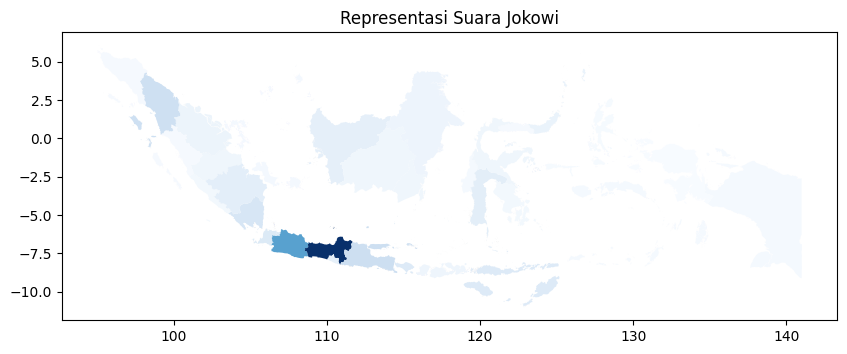

In [193]:
import geopandas as gpd
import matplotlib.pyplot as plt

gdf = gpd.GeoDataFrame(merged_df)

# Plot the map
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
gdf.plot(column='jokowi_votes', ax=ax, cmap='Blues')
plt.title('Representasi Suara Jokowi')
plt.show()


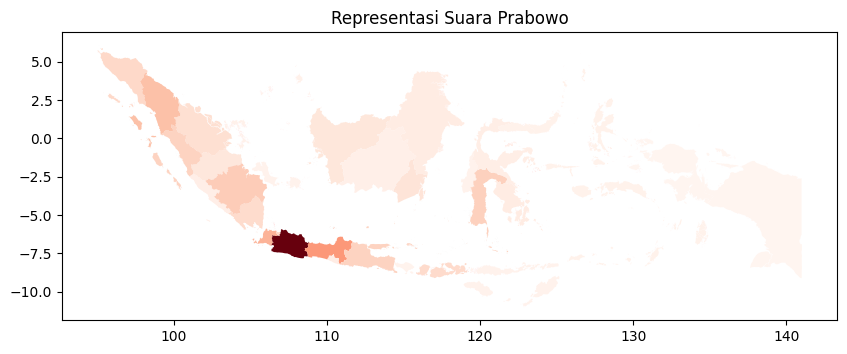

In [194]:
import geopandas as gpd
import matplotlib.pyplot as plt

gdf = gpd.GeoDataFrame(merged_df)

# Plot the map
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
gdf.plot(column='prabowo_votes', ax=ax, cmap='Reds')
plt.title('Representasi Suara Prabowo')
plt.show()


In [195]:
# import geopandas as gpd
# import matplotlib.pyplot as plt
# from matplotlib.colors import LinearSegmentedColormap

# merged_df['vote_difference'] = merged_df['jokowi_votes'] - merged_df['prabowo_votes']

# colors = [(0, 0, 1), (1, 0, 0)]  # Blue to Red

# cmap = LinearSegmentedColormap.from_list('custom_cmap', colors)
# gdf = gpd.GeoDataFrame(merged_df)


# fig, ax = plt.subplots(1, 1, figsize=(10, 10))
# gdf.plot(column='vote_difference', ax=ax, cmap=cmap)
# plt.title('Dominasi Jokowi(Merah) vs.Prabowo(Biru) pada Pemilu 2019')
# plt.show()


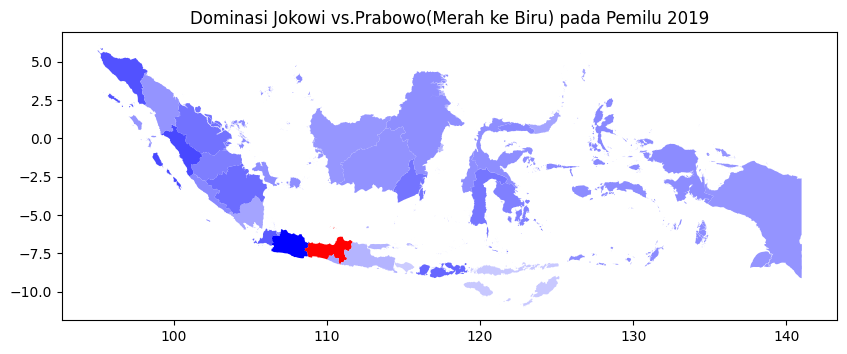

In [196]:
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap


merged_df['vote_difference'] = merged_df['jokowi_votes'] - merged_df['prabowo_votes']

colors = [(0, 0, 1), (1, 1, 1), (1, 0, 0)]  # Blue to White to Red
cmap = LinearSegmentedColormap.from_list('custom_cmap', colors)
gdf = gpd.GeoDataFrame(merged_df)


fig, ax = plt.subplots(1, 1, figsize=(10, 10))
gdf.plot(column='vote_difference', ax=ax, cmap=cmap)
plt.title('Dominasi Jokowi vs.Prabowo(Merah ke Biru) pada Pemilu 2019')
plt.show()


In [197]:
!pip install geoplot

In [198]:
merged_df = gpd.GeoDataFrame(merged_df)

In [199]:
#Membuat persentase suara pada tiap provinsi agar bisa membuat cartogram

# merged_df['total_votes'] = merged_df['jokowi_votes'] + merged_df['prabowo_votes']
# merged_df['jokowi_percentage'] = (merged_df['jokowi_votes'] / merged_df['total_votes']) * 100
# merged_df['prabowo_percentage'] = (merged_df['prabowo_votes'] / merged_df['total_votes']) * 100

total_jokowi_votes = merged_df['jokowi_votes'].sum()
total_prabowo_votes = merged_df['prabowo_votes'].sum()

merged_df['percentageFromTotalJ'] = (merged_df['jokowi_votes'] / total_jokowi_votes) * 100
merged_df['percentageFromTotalP'] = (merged_df['prabowo_votes'] / total_prabowo_votes) * 100




In [200]:
merged_df

,prov_name,jokowi_votes,prabowo_votes,NAME_1,pulau,geometry,vote_difference,percentageFromTotalJ,percentageFromTotalP
0,Aceh,365823.0,2097427.0,Aceh,Sumatera,"MULTIPOLYGON (((96.66509 2.12018, 96.66765 2.1...",-1731604.0,0.558922,3.715010
1,Bali,2337772.0,212452.0,Bali,Nusa Tenggara,"MULTIPOLYGON (((115.59464 -8.81672, 115.59444 ...",2125320.0,3.571759,0.376300
2,Bangka Belitung,495335.0,288045.0,Bangka Belitung,Sumatera,"MULTIPOLYGON (((107.96173 -3.41100, 107.96220 ...",207290.0,0.756796,0.510192
3,Banten,2381256.0,3818281.0,Banten,Jawa,"MULTIPOLYGON (((105.54977 -6.99566, 105.55035 ...",-1437025.0,3.638196,6.763026
4,Bengkulu,582845.0,585598.0,Bengkulu,Sumatera,"MULTIPOLYGON (((102.37586 -5.36968, 102.38067 ...",-2753.0,0.890498,1.037224
5,Gorontalo,369338.0,344798.0,Gorontalo,Sulawesi,"MULTIPOLYGON (((121.41933 0.41357, 121.41941 0...",24540.0,0.564292,0.610714
6,Jakarta Raya,2382820.0,2129658.0,Jakarta Raya,Jawa,"MULTIPOLYGON (((106.73563 -6.04014, 106.73548 ...",253162.0,3.640585,3.772098
7,Jambi,844848.0,1172457.0,Jambi,Sumatera,"MULTIPOLYGON (((104.40900 -0.85951, 104.40870 ...",-327609.0,1.290799,2.076682
8,Jawa Barat,9356537.0,13674439.0,Jawa Barat,Jawa,"MULTIPOLYGON (((108.68501 -6.76990, 108.68410 ...",-4317902.0,14.295360,24.220475
9,Jawa Tengah,16736624.0,4926870.0,Jawa Tengah,Jawa,"MULTIPOLYGON (((108.88353 -7.74846, 108.88322 ...",11809754.0,25.571006,8.726583


<GeoAxes: >

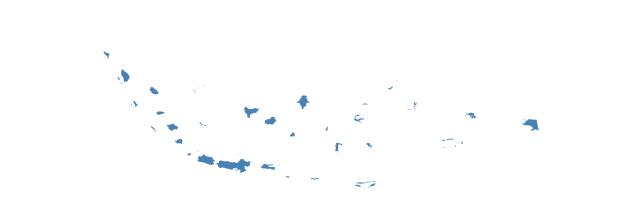

In [201]:
#Cartogram suara Jokowi
gplt.cartogram(
    merged_df,
    scale="percentageFromTotalJ",
    projection=gcrs.AlbersEqualArea()
)

<GeoAxes: >

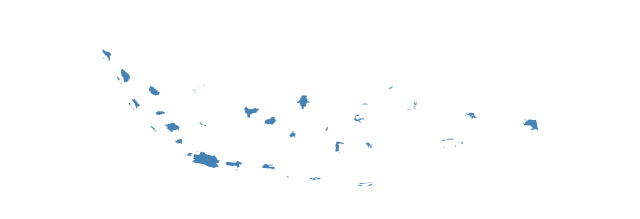

In [202]:
#Cartogram suara Prabowo
gplt.cartogram(
    merged_df,
    scale="percentageFromTotalP",
    projection=gcrs.AlbersEqualArea()
)